# Data Cleaning and Normalization

Importing Libraries that will be used for the project

In [1]:
#Importing Libraries
import pandas as pd
import unicodedata
import sys
import os
import numpy as np
import spacy
import nltk
import spacy
import matplotlib.pyplot as plt
import wordcloud
import re #for text cleaning
import random
import string #for text cleaning
import sklearn
import scattertext
from sklearn.metrics import precision_score
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import NMF
from sklearn.feature_extraction import text

from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

/shared-libs/python3.8/py/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


We will now load and read both the employer's and industry dataset using Pandas Library

In [2]:
#We will use pandas to load and read the industry and employe datasets
#Industry Dataset
industry_data = pd.read_csv('../assets/industry_data.csv')
industry_data.columns = ["label", "text"]

#Employer Dataset
employer_data = pd.read_csv('../assets/employer_raw_data_1.csv')
employer_data.columns = ["label", "text"]

We will merge both the industry and employer datasets.

In [3]:
data = pd.concat([industry_data, employer_data])

A preview of the dataset we just loaded

In [4]:
data.head()

,label,text
0,Financial Services,Financial services are the economic services p...
1,Agriculture and Mining,Agriculture and Mining. IntelliScience provide...
2,Business Services,Services used by the business enterprises in c...
3,Computer and Electronics,Consumer Electronics Computers & Computer Equi...
4,Energy and Utilities,"The future of energy, environment and utilitie..."


The dataset has two features; employers(companies) and their description.  

## Cleaning the Dataset

### Regex

We will create a sample Regex to clean up the Phone number.

Short for regular expression; a Regex is useful in extracting information from any text by searching for one or more matches of a specific search pattern 

In [5]:
model = "\+?\d{0,3}\s?\(?\d{3}\)?[-.\s]?\d{3}[-.\s]?\d{3,4}"
example = "My phone number is +1 (510)-228-9651"
re.findall(model, example)

['+1 (510)-228-9651']

"\+?\d{0,3}\s?" part is for country code.

It checks if there is any country code with 4 characters or less on the sentence.

The rest follow similar pattern but they check the 3/4 digit numbers of the phone.

The model works for Tanzanian and US phone numbers.

In [6]:
phone_regex = re.compile(model)
example1 = phone_regex.sub(' ', example)
print(example1)

My phone number is  


As you can see from the above code, the phone_regex gets rid of the phone number from the text.

In [7]:
sentences = data["text"].values

In [8]:
#Choosing a random sentence from the sentences in the dataset
sentence = random.choice(sentences)


In [9]:
def print_sentence(sentence):
    para_regex = re.compile(r"\. ")
    print(para_regex.sub("\n ", sentence))

In [10]:
print_sentence(sentence)

Sigma Systems is the global leader in catalog-driven software solutions for communications, media, and high-tech companies
 It serves over 80 customers in 40 countries with its award-winning products
 Sigma is an efficient and responsive vendor that understands the needs of student financial services offices and is always comfortable pushing the boundaries of what a processing system can do to improve efficiency and meet the overall strategic objectives of the customers we serve
 Find out what works well at Sigma Systems, Inc
 from the people who know best
 Get the inside scoop on jobs, salaries, top office locations, and CEO insights
 Compare pay for popular roles and read about the team’s work-life balance
 Uncover why Sigma Systems, Inc
 is the best company for you
 At Sigma Systems, we embrace the most demanding thermal challenges
 Let us help you go hotter and colder, faster and more precisely than anyone else
 Thermal Chambers
 Optimal test environments require thermal chambers c


We will use functions to remove unwanted information from our text that may not be helpful in classifying our random dataset.

These include:

    -Website/URL

    -Emails

    -Dates

    -Location(Eg; Vancouver,BC , Toronto, ON...)

    -String Operation to remove ; Numbers and Punctuations


Starting with a Website/URL Regex that will remove all url/website links from the dataset. We will run an example to make sure it works before incorporating it in the whole dataset

In [11]:
#Website/URL Regex

def remove_url(text):
    url_model = re.compile(r'https?://(\w+|www)+\.[a-zA-Z]{2,4}')
    return url_model.sub(r'', text)

example = "My college website is http://whittier.edu"
print(remove_url(example))

My college website is 


The Email Regex filters and removes all email addresses from the dataset.

In [12]:
#Email Regex

def remove_email(text):
    email_model = re.compile('[\w.-]+@[\w.-]+\.[a-zA-Z]{2,4}')
    return email_model.sub('', text)

example = "My college email is abamwend@poets.whittier.edu"
print(remove_email(example))

My college email is 


Let's put the Email Regex to use. 

We will print the sentence before and after applying the email regex to see If it worked on removing emails.

In [13]:
print_sentence(sentence)

Sigma Systems is the global leader in catalog-driven software solutions for communications, media, and high-tech companies
 It serves over 80 customers in 40 countries with its award-winning products
 Sigma is an efficient and responsive vendor that understands the needs of student financial services offices and is always comfortable pushing the boundaries of what a processing system can do to improve efficiency and meet the overall strategic objectives of the customers we serve
 Find out what works well at Sigma Systems, Inc
 from the people who know best
 Get the inside scoop on jobs, salaries, top office locations, and CEO insights
 Compare pay for popular roles and read about the team’s work-life balance
 Uncover why Sigma Systems, Inc
 is the best company for you
 At Sigma Systems, we embrace the most demanding thermal challenges
 Let us help you go hotter and colder, faster and more precisely than anyone else
 Thermal Chambers
 Optimal test environments require thermal chambers c

In [14]:
sentence = remove_email(sentence)
print_sentence(sentence)

Sigma Systems is the global leader in catalog-driven software solutions for communications, media, and high-tech companies
 It serves over 80 customers in 40 countries with its award-winning products
 Sigma is an efficient and responsive vendor that understands the needs of student financial services offices and is always comfortable pushing the boundaries of what a processing system can do to improve efficiency and meet the overall strategic objectives of the customers we serve
 Find out what works well at Sigma Systems, Inc
 from the people who know best
 Get the inside scoop on jobs, salaries, top office locations, and CEO insights
 Compare pay for popular roles and read about the team’s work-life balance
 Uncover why Sigma Systems, Inc
 is the best company for you
 At Sigma Systems, we embrace the most demanding thermal challenges
 Let us help you go hotter and colder, faster and more precisely than anyone else
 Thermal Chambers
 Optimal test environments require thermal chambers c

In [15]:
#checking all kinds of punctuations detected by the punctuation method
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

Next, we will create a fucntion that removes all string punctuations from the text

In [16]:
#String Operation Function for Punctuations

punc_removal = string.punctuation

def remove_punctuation(text):
    return text.translate(str.maketrans('', '', punc_removal))


Let's implement the remove_punctuation function and lowercase in the sentence

In [17]:
#punctuations and lowercase
sentence = remove_punctuation(sentence)
sentence = sentence.lower()

### Normalization

We create a function that normalizes text; This means our function will  transform a text into a canonical (standard) form. This means "running" will be transformed to "run"

In [18]:
def normalize_text(text):
    return unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')

sentence = normalize_text(sentence)
print(sentence)

sigma systems is the global leader in catalogdriven software solutions for communications media and hightech companies it serves over 80 customers in 40 countries with its awardwinning products sigma is an efficient and responsive vendor that understands the needs of student financial services offices and is always comfortable pushing the boundaries of what a processing system can do to improve efficiency and meet the overall strategic objectives of the customers we serve find out what works well at sigma systems inc from the people who know best get the inside scoop on jobs salaries top office locations and ceo insights compare pay for popular roles and read about the teams worklife balance uncover why sigma systems inc is the best company for you at sigma systems we embrace the most demanding thermal challenges let us help you go hotter and colder faster and more precisely than anyone else thermal chambers optimal test environments require thermal chambers configured for device size 

Let's do some Stemming techniques on our text

Stemming reduces a word to its word stem or to root known as a lemma. The objective of stemming is to reduce related words to the same stem even if the stem is not a dictionary word

We will look into three stemming techniques namely snowball, porter stemmer and ARLStem Stemmer.

In [19]:
#Stemming
#The Porter Stemmer
from nltk.stem.porter import *
stemmer = PorterStemmer()

my_words = ["flying","summarizer","moisturizer", "photosensitizer", "playing", "cups", "running", "sunset"]
stemmed_words = [stemmer.stem(my_word) for my_word in my_words]
print(' '.join(stemmed_words))


fli summar moistur photosensit play cup run sunset


The words in my_words have been reduced to their stems respectively. For instance: Moisturizer has been reduced to moistur

In [20]:
#Stemming
#Snowball Stemmer
from nltk.stem.snowball import SnowballStemmer

#Snowball Stemmer supports several languages so we will select an instance that supports english
stemmer = SnowballStemmer("english")
my_words = ["flying","summarizer","moisturizer", "photosensitizer", "playing", "cups", "running","sunset"]
stemmed_words = [stemmer.stem(my_word) for my_word in my_words]
print(' '.join(stemmed_words))


fli summar moistur photosensit play cup run sunset


In [21]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

I notice some of the words could not be returned to their stems when using both techniques.

I prefer Snowball Stemmer. It can also stem words in other languages.

In [22]:
#ARLStem Stemmer
from nltk.stem.arlstem import ARLSTem
stemmer = ARLSTem()

my_words = ["flying","summarizer","moisturizer", "photosensitizer", "playing", "cups", "running","sunset"]
stemmed_words = [stemmer.stem(my_word) for my_word in my_words]
print(' '.join(stemmed_words))


flying summarizer moisturizer photosensitizer playing cups running sunset


Lemmatization

Unlike stemming, lemmatization reduces words to their base word, reducing the inflected words properly and ensuring that the root word belongs to the language.

We will perform lemmatization using nltk and spacy library.



In [23]:
#Lemmatization
#Using nltk library - wordnet

nltk.download('wordnet')
lemmatizer = nltk.stem.WordNetLemmatizer()

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


In [24]:
nltk.download('omw-1.4')

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Unzipping corpora/omw-1.4.zip.


True

In [25]:
print(lemmatizer.lemmatize('running', 'v'))
print(lemmatizer.lemmatize('dogs', 'n'))
print(lemmatizer.lemmatize('hers', 'a'))

run
dog
hers


In [26]:
from nltk.corpus import wordnet as wn

wn.synsets('dog', pos=wn.NOUN)

[Synset('dog.n.01'),
 Synset('frump.n.01'),
 Synset('dog.n.03'),
 Synset('cad.n.01'),
 Synset('frank.n.02'),
 Synset('pawl.n.01'),
 Synset('andiron.n.01')]

In [27]:
!python -m spacy download en_core_web_sm >> /dev/null

2022-03-15 03:35:12.753058: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-15 03:35:12.753111: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.


In [28]:
#sentece before lemmatization
sentence

'sigma systems is the global leader in catalogdriven software solutions for communications media and hightech companies it serves over 80 customers in 40 countries with its awardwinning products sigma is an efficient and responsive vendor that understands the needs of student financial services offices and is always comfortable pushing the boundaries of what a processing system can do to improve efficiency and meet the overall strategic objectives of the customers we serve find out what works well at sigma systems inc from the people who know best get the inside scoop on jobs salaries top office locations and ceo insights compare pay for popular roles and read about the teams worklife balance uncover why sigma systems inc is the best company for you at sigma systems we embrace the most demanding thermal challenges let us help you go hotter and colder faster and more precisely than anyone else thermal chambers optimal test environments require thermal chambers configured for device size

In [29]:
#Lemmatization
#Using spacy library

nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

doc = nlp(sentence)

In [30]:
#sentence after lemmatization
sentence = " ".join(token.lemma_ for token in doc)
print_sentence(sentence)

sigma system be the global leader in catalogdriven software solution for communication medium and hightech company it serve over 80 customer in 40 country with its awardwinning product sigma be an efficient and responsive vendor that understand the need of student financial service office and be always comfortable push the boundary of what a processing system can do to improve efficiency and meet the overall strategic objective of the customer we serve find out what work well at sigma systems inc from the people who know good get the inside scoop on job salary top office location and ceo insight compare pay for popular role and read about the team worklife balance uncover why sigma systems inc be the good company for you at sigma system we embrace the most demanding thermal challenge let we help you go hotter and cold fast and more precisely than anyone else thermal chamber optimal test environment require thermal chamber configure for device size temperature range transition speed and

In [31]:
text = "flying summarizer moisturizer photosensitizer playing cups running sunset"
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
#Creating a lemmatize function
def lemmatize(text: str):
    doc = nlp(text)
    text = " ".join(token.lemma_ for token in doc)
    return text

print(lemmatize(text))

fly summarizer moisturizer photosensitizer playing cup run sunset


In [32]:
#Removing Stop Words.
#We will use NLTK Library to remove them by dividing your text into words
#and then remove the word if it exits in the list of stop words provided by NLTK.

from nltk.corpus import stopwords
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [33]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

### Tokenization


Tokenization is basically splitting/segmenting a text into words/sentences. It cuts a text into pieces called tokens.These tokens help in understanding the context and developing the model for the NLP. 

In this project. We will use word_tokenize to split the text into words.

In [34]:
from nltk.tokenize import word_tokenize

text = "She likes to dance even though she is not a huge fan of dancehall."
text_tokens = word_tokenize(text)

#We will filter the tokens and only remain with words that are not stopwords
tokens_without_sw = [word for word in text_tokens if not word in stopwords.words()]

print(tokens_without_sw)

['She', 'likes', 'dance', 'even', 'though', 'huge', 'fan', 'dancehall', '.']


Tokenization can also be done without using the nltk librabry. 

We will manially split the whole text into individual words by using split() method

In [35]:
# You can tokenize as follow to not use nltk
tokens = sentence.split(" ")
tokens

['sigma',
 'system',
 'be',
 'the',
 'global',
 'leader',
 'in',
 'catalogdriven',
 'software',
 'solution',
 'for',
 'communication',
 'medium',
 'and',
 'hightech',
 'company',
 'it',
 'serve',
 'over',
 '80',
 'customer',
 'in',
 '40',
 'country',
 'with',
 'its',
 'awardwinning',
 'product',
 'sigma',
 'be',
 'an',
 'efficient',
 'and',
 'responsive',
 'vendor',
 'that',
 'understand',
 'the',
 'need',
 'of',
 'student',
 'financial',
 'service',
 'office',
 'and',
 'be',
 'always',
 'comfortable',
 'push',
 'the',
 'boundary',
 'of',
 'what',
 'a',
 'processing',
 'system',
 'can',
 'do',
 'to',
 'improve',
 'efficiency',
 'and',
 'meet',
 'the',
 'overall',
 'strategic',
 'objective',
 'of',
 'the',
 'customer',
 'we',
 'serve',
 'find',
 'out',
 'what',
 'work',
 'well',
 'at',
 'sigma',
 'systems',
 'inc',
 'from',
 'the',
 'people',
 'who',
 'know',
 'good',
 'get',
 'the',
 'inside',
 'scoop',
 'on',
 'job',
 'salary',
 'top',
 'office',
 'location',
 'and',
 'ceo',
 'insight

# Word representation

In [36]:
#StopWords
with open("../assets/stopwords.txt", "r") as f:  # type:ignore[name-defined]
    STOPWORDS = [i.strip().lower() for i in f.readlines()]

### Preprocessing

We will generalize all preprocesing tasks in a single function. 

Our tasks will include removing emails, numbers, punctuation, changing all letters to lowercase, lemmatizing and stemming.

In [37]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [38]:
!python -m spacy download en_core_web_sm >> /dev/null

2022-03-15 03:35:36.917635: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-15 03:35:36.917690: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.


In [39]:
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer("english")
from nltk.tokenize import sent_tokenize, word_tokenize
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

#the preprocessing function
def preprocessing_func(
    use_lower: bool = True,
    use_alpha: bool = True,
    use_stemming: bool = True,
    use_lemmatize: bool = True,
    use_punctuation: bool = True,
    use_digits: bool = True,
    use_email: bool = True,
    use_url: bool = True,
    use_phone:bool = True,

):
    email_re = re.compile('[\w.-]+@[\w.-]+\.[a-zA-Z]{2,4}')
    phone_re = re.compile("\+?\d{0,3}\s?\(?\d{3}\)?[-.\s]?\d{3}[-.\s]?\d{3,4}")
    url_re = re.compile(r'https?://(\w+|www)+\.[a-zA-Z]{2,4}')
    digit_model = re.compile('\d.-')
    puncts = string.punctuation

    #Email
    def remove_email(text : str):
        return email_re.sub('', text) if use_email else text

    #Website/URL
    def remove_url(text : str):
        return url_re.sub(r'', text) if use_url else text

    #Digits
    def remove_digits(text : str):
        return digit_model.sub('', text) if use_digits else text

    #Phone Number
    def remove_phonenumber(text: str):
        return phone_re.sub('', text) if use_phone else text

    #Punctuation
    def remove_punctuation(text : str):
        return text.translate(str.maketrans(' ', ' ', puncts)) if use_punctuation else text


    #Alpha
    def alpha(text: str):
        return re.sub("[^a-zA-Z]+", " ", text) if use_alpha else text

    #Lower Case
    def lower(text: str):
        return text.lower() if use_lower else text

    #Stemming
    def stemming(text: str):
        if use_stemming:
            tokens = text.split(" ")
            for word in tokens:
                stemmer.stem(word)
            text = " ".join(tokens)
        return text

    #Lemmatization  
    def lemmatize(text: str):
        if use_lemmatize:
            doc = nlp(text)
            text = " ".join(token.lemma_ for token in doc)
        return text

    def preprocess(text: str):
        #Creating a list of steps for the function to run
        steps = [remove_email, remove_url,remove_digits, remove_punctuation, lower, alpha, stemming, lemmatize]
        for step in steps:
            text = step(text)
        return text
    
    return preprocess
    

In [40]:
preprocess = preprocessing_func(
    use_lower = True,
    use_alpha = True,
    use_stemming = False,
    use_punctuation = False,
    use_digits= True,
    use_lemmatize = False
)

In [41]:
#industry
industry_data["text"] = industry_data["text"].fillna(".")
industry_data["text"] = industry_data["text"].astype(str)

In [42]:
#employer_data
employer_data["text"] = employer_data["text"].fillna(".")
employer_data["text"] = employer_data["text"].astype(str)

In [43]:
industry_data["text"].values[7]

'What is a "Nonprofit"? Printer-friendly version. Charitable nonprofits embody the best of America. They provide a way for people to work together for the common good, transforming shared beliefs and hopes into action. They give shape to our boldest dreams, highest ideals, and noblest causes. America’s 1.3 million charitable nonprofits feed ... Find the best non-profit or charity in Los Angeles, CA https://greatnonprofits.org GreatNonprofits Over 1.8 million nonprofits and charities for donors, volunteers and funders A nonprofit organization or foundation (NPO), also known as a non-business entity, not-for-profit organization, or nonprofit institution, is dedicated to furthering a particular social cause or advocating for a shared point of view. Charitable Organizations — IRC 501(c)(3) Organizations that are organized and operated exclusively for religious, charitable, scientific, testing for public safety, literary, educational or other specified purposes. A nonprofit organization (NP

In [44]:
employer_data["text"].values[6]

'Neelkanth Tech Services Inc. Brooklands. House Cleaning. Get a free quote from this professional. Get a free quote from this professional. Contact Send Email About. Reviews. Leave a review. Be the first to leave a review for Neelkanth Tech Services Inc. ... Neelkanth Tech Services Inc Winnipeg, MB Contact Refer Recommendations Given (1) Krishna Parekh. SKILL TRADE LIKE (ELECTRICIAN / MILLWRIGHT / PLC TRAINING. Highly Recommended "He is a good professional trainer." See more Are you sure you want to delete this recommendation? Cancel Delete Winnipeg, MB R2N1E7. NEELKANTH DECORATIVE ACCESSORIES is located in Ahmedabad, Gujarat, India and is part of the Other Professional, Scientific, and Technical Services Industry. NEELKANTH DECORATIVE ACCESSORIES has 13 total employees across all of its locations. (Employees figure is modelled). Neelkanth Group of Institutions, Meerut [UP] are the Best Colleges in NCR, West U.P. and North India that offers various Undergraduate and Post graduate Cours

In [45]:
sentences = industry_data["text"].values
sentence = random.choice(sentences)
processed_sentence = preprocess(sentence)

print(f"""
Non processed corpus:
{sentence}
------------------------
Processed corpus:
{processed_sentence}
""")


Non processed corpus:
Agriculture and Mining. IntelliScience provides flexible, high-fidelity, real-time, touch-free measurement solutions to support the most complex precision agriculture and mining operations. Agriculture and Mining. Improving operations often boils down to using information to act with more precision and to react faster. The Growing Battle between Mining and Agriculture. Mining often sets up a direct competition with small-scale agriculture for control of land. “Si a la vida, no a la mina” (Yes to life, no to the mine) is a rallying cry heard across many parts of rural Latin America these days. Mining, as well as oil and gas extraction, has exploded across ... Agriculture and Mining: Can They Coexist? August 17, 2020. Mining is the extraction of minerals, ores, clay, fossil fuels, gravel and stone, among other commodities. The increase in demand for minerals, such as gold and silver, has influenced a steady rise in metal mining and mineral extraction from the ore o

In [46]:
sentences = employer_data["text"].values
sentence = random.choice(sentences)
processed_sentence = preprocess(sentence)

print(f"""
Non processed corpus:
{sentence}
------------------------
Processed corpus:
{processed_sentence}
""")


Non processed corpus:
Home · Bessemer Venture Partners. Ben Silbermann, Pinterest. Forge ahead. For the entrepreneurs who want to create revolutions of their own. Jennifer Tejada, PagerDuty. Forge ahead. For the entrepreneurs who want to create revolutions of their own. Jeff Lawson, Twilio. Forge ahead. Bessemer Venture Partners was born from innovations in steel that literally forged modern building and manufacturing. Today, we work with people who want to create revolutions of their own. Bessemer Venture Partners (Bessemer) is an American venture capital firm. The firm has over $10 billion under management and invests globally, with offices in San Francisco, Redwood City, New York City, Boston, Israel, and India. Bessemer Venture Partners is a $4B venture capital firm that funds consumer, enterprise, and healthcare startups around the world, from seed stage to growth. Their partners help founders lay enduring foundations to create companies that matter, starting with seed and Series

### Vectorization

Word vectorization is a methodology in NLP to map words or phrases from vocabulary to a corresponding vector of real numbers which is used to find word predictions, word similarities/semantics.


### Hashing Vectorizer

The vectorizer applies the hashing trick to encode tokens as numerical indexes. 

The hashing trick turns arbitrary features into indices in a vector or matrix. It works by applying a hash function to the features and using their hash values as indices directly.

The advantages:

- It is designed to be very memory efficient.
- It can be used in streaming or parallel pipeline

The downsides:

- Once vectorized, the features' names can no longer be retrieved(No inverse).
- There can be collisions: distinct tokens can be mapped to the same feature index. 

In [47]:
from sklearn.feature_extraction.text import HashingVectorizer
#industry
hash_vectorizer = HashingVectorizer(
    preprocessor = preprocess,
    stop_words = STOPWORDS,
    tokenizer=lambda s: s.split(" "),
    n_features= 2**20,
)


vector = hash_vectorizer.fit_transform(industry_data["text"])

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [48]:
print(vector.shape)
print(vector[0]) # As sparse matrice representation

(13, 1048576)
  (0, 0)	0.00812659055482068
  (0, 292)	0.00812659055482068
  (0, 1907)	-0.00812659055482068
  (0, 2067)	0.00812659055482068
  (0, 5658)	-0.0812659055482068
  (0, 6509)	-0.00812659055482068
  (0, 7620)	-0.024379771664462042
  (0, 11897)	0.01625318110964136
  (0, 12604)	0.00812659055482068
  (0, 12930)	-0.0406329527741034
  (0, 19372)	-0.01625318110964136
  (0, 20811)	-0.00812659055482068
  (0, 21083)	-0.00812659055482068
  (0, 22116)	-0.00812659055482068
  (0, 23174)	0.00812659055482068
  (0, 23793)	0.00812659055482068
  (0, 26523)	-0.024379771664462042
  (0, 26579)	0.00812659055482068
  (0, 27515)	0.00812659055482068
  (0, 27551)	0.0406329527741034
  (0, 29537)	0.01625318110964136
  (0, 29625)	-0.00812659055482068
  (0, 30393)	0.6663804254952957
  (0, 31052)	0.00812659055482068
  (0, 33189)	0.024379771664462042
  :	:
  (0, 1021683)	0.00812659055482068
  (0, 1024073)	-0.024379771664462042
  (0, 1024718)	0.00812659055482068
  (0, 1025570)	0.00812659055482068
  (0, 1025827)

In [49]:
#employer
vectors = hash_vectorizer.fit_transform(employer_data["text"])
print(vectors.shape)
vector = vectors[0].todense()

(20000, 1048576)


### Details on parameters used in Hashing Vectorizer

preprocessor => Overrides the preprocessing (string transformation) stage while preserving the tokenizing and n-grams generation steps. Only applies if analyzer is not callable.

tokenizer => Overrides the string tokenization step while preserving the preprocessing and n-grams generation steps. Only applies if analyzer == 'word'.

n_features =>  refers to the number of features (columns) in the output matrices.

### NMF - Non-Negative Matrix Factorization

https://docs.google.com/presentation/d/1XwdnTFRSUmKHyBsopFWUbTSxGhDe_IXy4AH3xbk2mrQ/edit?usp=sharing

In [50]:
#Parameters that we can Modify in TFIDF
NGRAM = (1, 1) #Add more features when context is needed
MIN_DF = 5 #The more, the more specific
MAX_DF = 0.75 #The less, the more specific
MAX_FEATURES = None #Defines the length of the vocabulary

In [51]:
#TFIDF
#We will use tfidf vectorizer for our topic model in NMF.

tfidf_vector = TfidfVectorizer(
    preprocessor = preprocess,
    ngram_range = NGRAM,
    tokenizer=lambda x: x.split(),
    stop_words=STOPWORDS,
    min_df=MIN_DF,
    max_df=MAX_DF,
    max_features=MAX_FEATURES,
    use_idf=True,
    smooth_idf=True,
)

In [52]:
data = pd.concat([industry_data, employer_data])

In [53]:
# converting the data into a  term-document matrix
vectors = tfidf_vector.fit_transform(data["text"])
#print(vectors.todense()[0])

In [54]:
words = tfidf_vector.get_feature_names()

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [55]:
print("Tfidf words = ", words)

Tfidf words =  ['aa', 'aaa', 'aaaa', 'aac', 'aachen', 'aacn', 'aacr', 'aacsb', 'aad', 'aadvantage', 'aaf', 'aafes', 'aag', 'aah', 'aaha', 'aai', 'aal', 'aam', 'aama', 'aamc', 'aan', 'aanbod', 'aap', 'aar', 'aargau', 'aarhus', 'aaron', 'aarp', 'aas', 'aayush', 'ab', 'aba', 'ababa', 'abaco', 'abad', 'abandon', 'abandoned', 'abandonment', 'abap', 'abarth', 'abatement', 'abb', 'abba', 'abbas', 'abbe', 'abbeville', 'abbey', 'abbie', 'abbot', 'abbotsford', 'abbott', 'abbr', 'abbreviated', 'abbreviation', 'abbreviations', 'abbvie', 'abby', 'abc', 'abd', 'abdel', 'abdomen', 'abdominal', 'abduction', 'abdul', 'abdulaziz', 'abdullah', 'abdulrahman', 'abe', 'abebooks', 'abed', 'abel', 'aber', 'abercorn', 'abercrombie', 'aberdeen', 'abernathy', 'abg', 'abgegeben', 'abhijit', 'abhishek', 'abi', 'abide', 'abides', 'abiding', 'abidjan', 'abierta', 'abierto', 'abigail', 'abilene', 'abilities', 'ability', 'abingdon', 'abington', 'abk', 'abl', 'ablation', 'able', 'abloy', 'abm', 'abn', 'abnormal', 'abno

#Parameters and Methods explained.

fit_transform(X[, y, W, H]) -> Learn a NMF model for the data X and returns the transformed data.

n_components is the  Number of components.

components_  Factorization Matrix. Referred to as a 'dictionary' at times.

In [56]:
# Applying Non-Negative Matrix Factorization on whole data
nmf = NMF(n_components = 25, solver="cd",init='random', random_state=0)
W = nmf.fit_transform(vectors)
H = nmf.components_
words = np.array(words)
topic_top_words = {}

for i, topic in enumerate(H):
     topic_top_words[f"Topic {i + 1}"] = ", ".join([str(x) for x in words[topic.argsort()[-10:]]])

Solver{‘cd’, ‘mu’}, default=’cd’
-Numerical solver to use: ‘cd’ is a Coordinate Descent solver. ‘mu’ is a Multiplicative Update solver.

init
-Method used to initialize procedure

random_state
-Used for initialization

In [57]:
topic_top_words

{'Topic 1': 'ca, assistant, san, nurse, pharmacy, months, california, manager, permanente, kaiser',
 'Topic 2': 'envy, therapists, pain, therapeutic, wellness, therapist, body, chiropractic, therapy, massage',
 'Topic 3': 'children, student, academy, high, education, college, district, students, schools, school',
 'Topic 4': 'home, homes, construction, group, commercial, properties, realty, property, real, estate',
 'Topic 5': 'campus, heights, akron, avon, euclid, center, oh, ohio, clinic, cleveland',
 'Topic 6': 'reviews, free, online, service, store, new, portland, restaurant, club, food',
 'Topic 7': 'pvt, co, china, pte, india, pty, singapore, company, limited, ltd',
 'Topic 8': 'office, york, county, attorneys, court, attorney, legal, firm, llp, law',
 'Topic 9': 'management, ventures, venture, investment, private, fund, firm, equity, partners, capital',
 'Topic 10': 'community, plan, behavioral, wellness, services, mental, system, care, healthcare, health',
 'Topic 11': 'sie, de

### WordCloud

WordCloud is a technique to show which words are the most frequent among the given text

In [58]:
# Do this for each topic
freq = {}
#for i in range (3):
    #for w, score in zip(words, H[i]):
        #freq[w] = score

for w, score in zip(words, H[0]):
    freq[w] = score


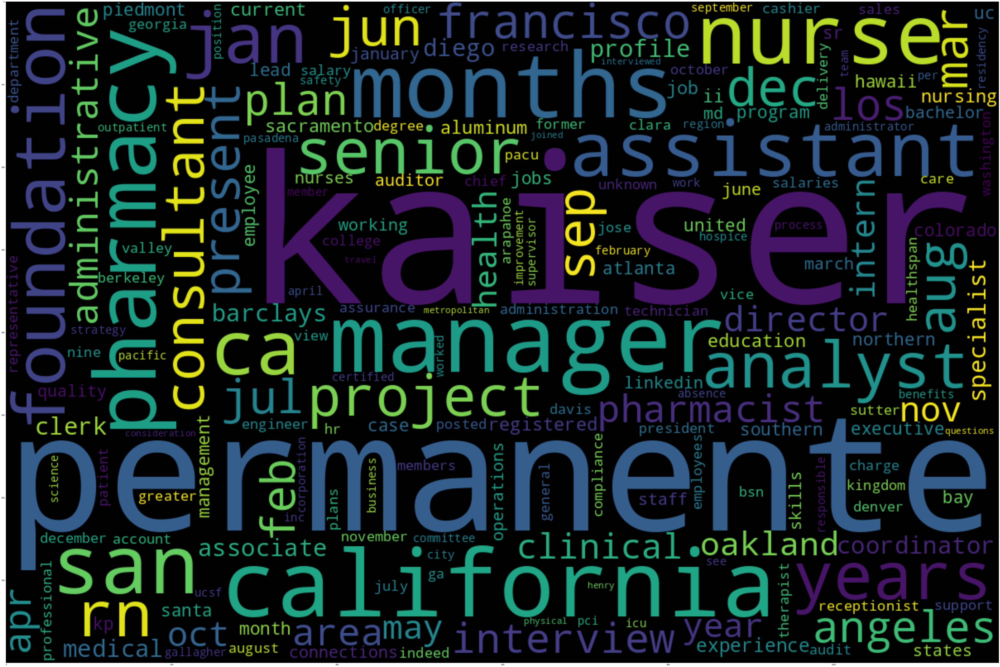

In [59]:
# Create and generate a word cloud image:
wordcloud = WordCloud(width = 1200, height = 800).generate_from_frequencies(freq)

# Display the generated image:
fig = plt.figure(figsize=(100,100))
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

In [60]:
freq = {}

for w, score in zip(words, H[12]):
    freq[w] = score


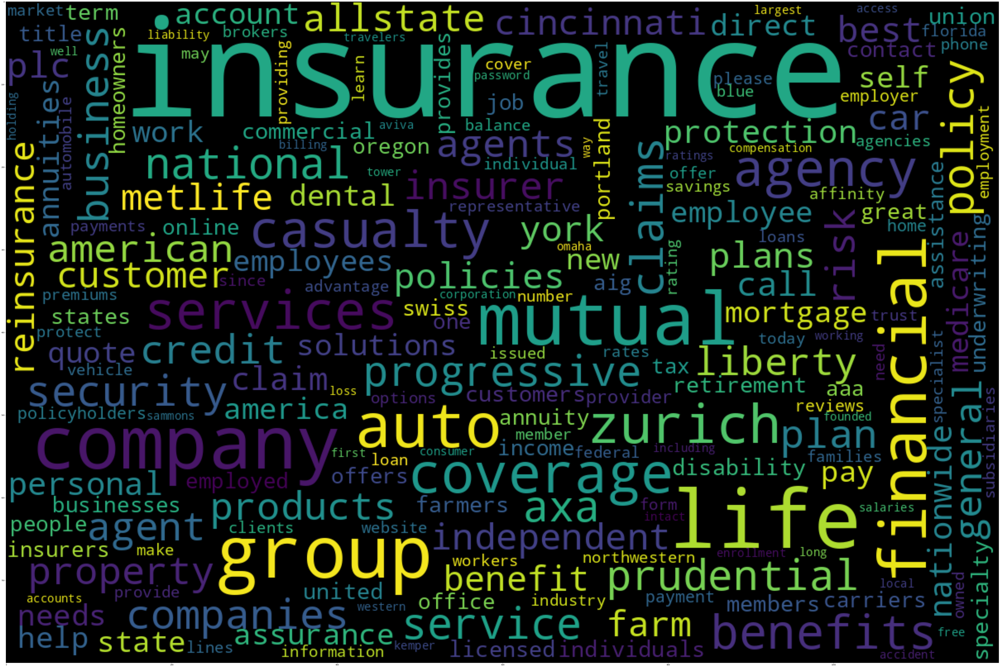

In [61]:
# Create and generate a word cloud image:
wordcloud = WordCloud(width = 1200, height = 800).generate_from_frequencies(freq)

# Display the generated image:
fig = plt.figure(figsize=(100,100))
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

In [62]:
freq = {}

for w, score in zip(words, H[8]):
    freq[w] = score

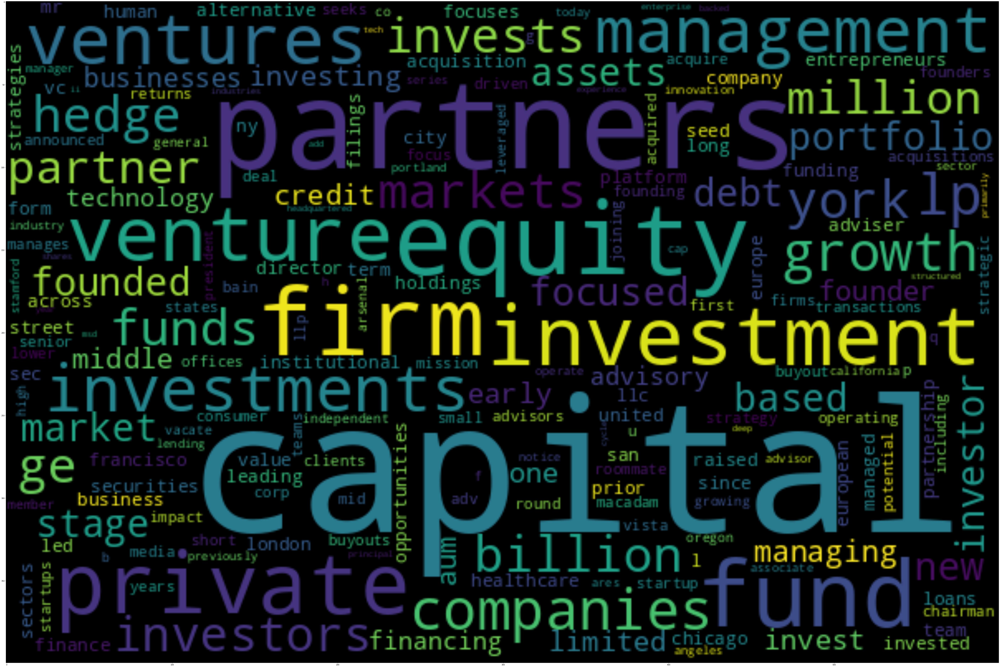

In [63]:
# Create and generate a word cloud image:
wordcloud = WordCloud(width = 600, height = 400).generate_from_frequencies(freq)

# Display the generated image:
fig = plt.figure(figsize=(100,100))
plt.imshow(wordcloud, interpolation='bilinear')
plt.show()

After the first view of our wordcloud, we will improve it by changing some optional arguments of the WordCloud like max_font_size, max_word,stopwords and background_color.

 interpolation="bilinear" in the plt.imshow() is to make the displayed image appear more smoothly.

### Cosine Similarity

Metric used to determine how two texts are similar in terms of context/meaning irrespective of their size(s)

A word is represented into a vector form. The text documents are represented in n-dimensional vector space.

Mathwise: Cosine similarity metric measures the cosine of the angle between two n-dimensional vectors projected in a multi-dimensional space.

It ranges between 0 and 1. Values closer to 0 means the two vectors have minimum similarity whereas closer to 1 mean they have more similarity.




In [64]:
from numpy import dot
from numpy.linalg import norm

def cos_sim(a, b):
    return dot(a, b)/(norm(a)*norm(b))

In [65]:
#We are splitting the W vector that represented all data into industry and employer vectors.
industry_vectors = W[:13]
employer_vectors = W[13:]

In [66]:
from tqdm import tqdm

In [67]:
industries = industry_data["label"].values
industry_results = []
for employer in tqdm(employer_vectors):
    res = []
    for i, vec in enumerate(industry_vectors):
        res.append(cos_sim(employer, industry_vectors[i]))
    industry_results.append(industries[np.argmax(res)])

 14%|█▍        | 2802/20000 [00:01<00:08, 2147.24it/s]<ipython-input-64-4351992f4a61>:5: RuntimeWarning: invalid value encountered in double_scalars
  return dot(a, b)/(norm(a)*norm(b))
100%|██████████| 20000/20000 [00:08<00:00, 2353.92it/s]


In [68]:
employer_data["nmf_result"] = industry_results

In [69]:
employer_data.to_csv("../assets/employer_nmf_result.csv", index=False)

In [70]:
employer_nmf_result = pd.read_csv("../assets/employer_nmf_result.csv")

In [71]:
employer_nmf_result["nmf_result"]


0            Media and Entertainment
1            Media and Entertainment
2        Health, Pharma, and Biotech
3            Media and Entertainment
4                  Consumer Services
                    ...             
19995              Business Services
19996              Business Services
19997        Media and Entertainment
19998                  Manufacturing
19999       Computer and Electronics
Name: nmf_result, Length: 20000, dtype: object

In [72]:
# from collections import Counter
# def get_industry_distribution(industries: List[str]) -> Dict[str, int]:
#     pass

# industry_distribution = {
#     "Education": 1000,
    
# }

### Evaluating our NMF Model

We will add all the nmf results a dictionary that keeps track of their frequencies in predicting employer's industry.

Thearefter we will plot the dictionary on a bar plot and check the distribution of the results to determine if it is skewed or uniform

Text(0.5, 1.0, 'Distribution of Predicted Industries')

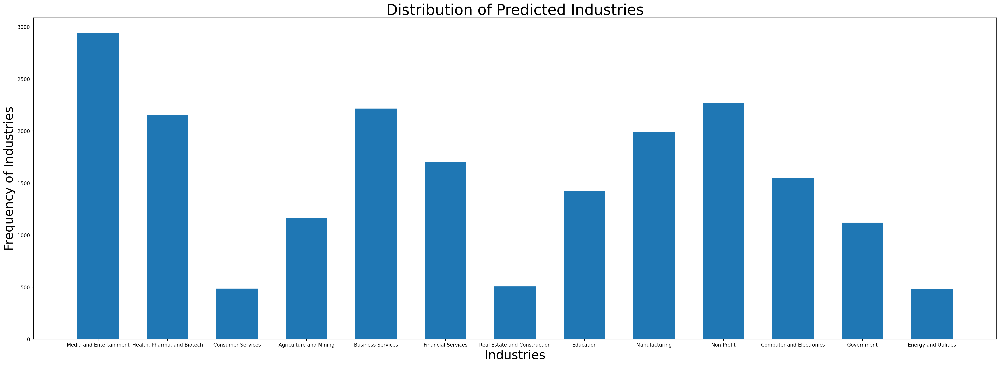

In [73]:
from collections import Counter # Counter is a subclass of dict that  keeps count without repeatition
industry_list = employer_nmf_result["nmf_result"]  # saving nmf_results in a list
#print(industry_list)
industry_distribution = Counter(industry_list)
#print(industry_distribution)

#Ploting our counter on a bar graph
plt.figure(figsize=(35,12), dpi=200, ) # figsize gives us weight and height of our plot
plt.bar(x = industry_distribution.keys(), height = industry_distribution.values(), width = 0.6)
plt.ylabel('Frequency of Industries', fontsize=25)
plt.xlabel('Industries', fontsize=25)
plt.title("Distribution of Predicted Industries", fontsize=30)

From the plot, "Customer Service", "Real Estate and Construction", and "Energy and Utilities" seem to be underrepresented. This could be because the data is skewed or could also be because there are less companies/employers in such industries.

We will further use random examples to explore the model on a deeper level.

In [74]:
#Let's try to pick 20 random employees and check how they were classified in nmf_results
industry_df = employer_nmf_result[["label", "nmf_result"]]
print(industry_df.sample(10))

                              label                   nmf_result
11740                       balunsd                   Non-Profit
12478         smouha tourist center      Media and Entertainment
12617            liberty global inc                Manufacturing
7715              carmichael fisher      Media and Entertainment
17580                          bvca  Health, Pharma, and Biotech
17587                     allstream     Computer and Electronics
19073  mithras investment trust plc           Financial Services
16713         the connection church                   Non-Profit
5588            ccmt/ school clinic                    Education
2816                           job2                   Non-Profit


From the random sample:

When a sample of 10 random employees were classified, most of them were classified into their specific industry. 

For instance: lionbridge and technpologies was classified in Computer and Electronics, cazenovia college: Education, edify technologies: Computer and Electronics,  energy programs consortium: Energy and Utilities..
Here, most employers names have words that resemble the industries names. For instance: Energy programs consortium is predicted to be in energy and utilities

Some employees that were incorrectly classified were: 
university of connecticut-residential life: Agriculture and Mining, toyota of Santa Monica: Agriculture and Mining..These both included locatoins. The location could have caused the misallocation

## Nmf model on Top Words

In [75]:
#tf-idf using top words

top_w = 20 # number of top words that we will use

words = np.array(tfidf_vector.get_feature_names())
results = [] # saving them into our list
for i in range(vectors.shape[0]):
    # Will get the words that are in the TFIDF which have the higher score
    # We use -vectors because the order is ascending
    s = np.argsort(np.asarray(-vectors[i, :].todense()).flatten())
    results.append(" ".join(words[s[:top_w]]))

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [76]:
# printing some of the topwords
print(words[s[:25]])

['hilton' 'worldwide' 'hotels' 'holdings' 'hospitality' 'hotel' 'conrad'
 'honors' 'argued' 'assets' 'curio' 'resorts' 'hlt' 'timeshare'
 'properties' 'petitioner' 'tower' 'portfolio' 'franchises' 'respondent'
 'company' 'total' 'sign' 'join' 'brands']


In [77]:
sentence_1 = random.choice(results)
sentence_2 = random.choice(results)
print(sentence_1)
print(sentence_2)

tails entail dental chakra involve tailed backstory ten elsie stab figure water coin affinity spirit shop clinics noticed sage motorcycle
child draper care days riverton ut daycare center advertisement age carmel inquire day missed parents preschool ages preschools children stars


In [78]:
#tfidf on the results from top words

topwords_tfidf = tfidf_vector.fit(results)
topwords_vectors = tfidf_vector.transform(results)

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [79]:
len(topwords_tfidf.get_feature_names())
print(topwords_tfidf.get_feature_names())

['aa', 'aaa', 'aachen', 'aacsb', 'aaf', 'aan', 'aaron', 'ab', 'aba', 'abb', 'abbey', 'abbott', 'abbreviated', 'abbreviation', 'abbreviations', 'abbvie', 'abby', 'abc', 'abdominal', 'abdul', 'abdulaziz', 'abdullah', 'abel', 'abercrombie', 'aberdeen', 'abi', 'abigail', 'abilene', 'abilities', 'ability', 'abingdon', 'able', 'abm', 'abn', 'abnormal', 'abolished', 'aboriginal', 'abortion', 'abp', 'abraham', 'abroad', 'abs', 'absa', 'absence', 'absentee', 'absolute', 'absolutely', 'abstract', 'abu', 'abuse', 'abv', 'ac', 'aca', 'academia', 'academic', 'academically', 'academics', 'academies', 'academy', 'acc', 'acca', 'accc', 'accelerate', 'accelerated', 'accelerating', 'acceleration', 'accelerator', 'accent', 'accenture', 'acceptance', 'accepted', 'accepting', 'accepts', 'access', 'accessed', 'accessibility', 'accessible', 'accessories', 'accident', 'accidents', 'accommodation', 'accommodations', 'accomplish', 'accordance', 'accorded', 'according', 'account', 'accountability', 'accountable'

In [80]:
nmf = NMF(n_components = 25, solver="cd",init='random', random_state=0)
W = nmf.fit_transform(topwords_vectors)
H = nmf.components_
words = np.array(words)
topic_top_words = {}

for i, topic in enumerate(H):
     topic_top_words[f"Topic {i + 1}"] = ", ".join([str(x) for x in words[topic.argsort()[-10:]]])

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


In [81]:
#We are splitting the W vector that represented all data into industry and employer vectors.
industry_vectors = W[:13]
employer_vectors = W[13:]

#print(industry_vectors)
print(employer_vectors)


[[0.01626052 0.         0.         ... 0.00024689 0.         0.0032769 ]
 [0.         0.         0.0125021  ... 0.         0.04576519 0.        ]
 [0.         0.         0.         ... 0.         0.03614238 0.        ]
 ...
 [0.00135215 0.         0.         ... 0.00270934 0.00558625 0.01692825]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.02079523 ... 0.         0.         0.        ]]


In [82]:
employer_vectors.shape

(20000, 25)

In [83]:
industries = industry_data["label"].values
topwords_results = []
for employer in tqdm(employer_vectors):
    res = []
    for i, vec in enumerate(industry_vectors):
        res.append(cos_sim(employer, industry_vectors[i]))
    topwords_results.append(industries[np.argmax(res)])


employer_data["topwords_result"] = topwords_results

100%|██████████| 20000/20000 [00:09<00:00, 2096.84it/s]


In [84]:
employer_data.to_csv("../assets/employer_topwords_result.csv", index=False)

In [85]:
employer_topwords_result = pd.read_csv("../assets/employer_topwords_result.csv")

In [86]:
employer_topwords_result["topwords_result"]

0                  Consumer Services
1            Media and Entertainment
2        Health, Pharma, and Biotech
3             Agriculture and Mining
4             Agriculture and Mining
                    ...             
19995    Health, Pharma, and Biotech
19996                     Non-Profit
19997        Media and Entertainment
19998                  Manufacturing
19999        Media and Entertainment
Name: topwords_result, Length: 20000, dtype: object

After looking through the topwords_results, it looks seems identical to the nmf_results.

This could be because both techniques have similar perfomance or because my topwords vectors have bugs.

## Industry prediction using Word Vector

In [87]:
'/root/venv/bin/python -m pip install --upgrade pip'

'/root/venv/bin/python -m pip install --upgrade pip'

In [88]:
!python -m spacy download en_core_web_sm

2022-03-15 03:41:04.435331: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-15 03:41:04.435498: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
     |████████████████████████████████| 13.9 MB 17.9 MB/s 
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [89]:
data["text"] = data["text"].fillna(".")
data["text"] = data["text"].astype(str)
data["text"] = data["text"].apply(preprocess)
sentences = data["text"].values

In [91]:
!python -m spacy download en_core_web_md

2022-03-15 03:43:48.244740: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-15 03:43:48.244794: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
     |████████████████████████████████| 45.7 MB 30.2 MB/s 
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_md')


In [92]:
# importing the spacy library
model = spacy.load('en_core_web_md', disable=['parser','ner'])

In [93]:
# using our tf-idf vector to fit and trasnform the data
vec = tfidf_vector.fit(sentences)
vectors = vec.transform(sentences)

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


In [94]:
#We will call Vocabulary attribute to see all the words learned by the tfidf_Vector 
#along with the index the model stores the word
vec.vocabulary_

{'financial': 14811,
 'services': 35625,
 'economic': 12370,
 'provided': 31534,
 'finance': 14804,
 'industry': 19618,
 'encompasses': 12975,
 'broad': 5174,
 'range': 32251,
 'businesses': 5555,
 'manage': 23876,
 'money': 25718,
 'including': 19462,
 'credit': 9357,
 'unions': 41312,
 'banks': 3370,
 'card': 6022,
 'companies': 8028,
 'insurance': 20030,
 'accountancy': 264,
 'consumer': 8622,
 'stock': 37807,
 'brokerages': 5211,
 'investment': 20356,
 'funds': 15857,
 'individual': 19574,
 'managers': 23884,
 'government': 16782,
 'sponsored': 37274,
 'enterprises': 13189,
 'sector': 35315,
 'primary': 31041,
 'driver': 11959,
 'nation': 26476,
 'economy': 12378,
 'provides': 31539,
 'free': 15599,
 'flow': 15135,
 'capital': 5954,
 'liquidity': 22969,
 'marketplace': 24123,
 'strong': 38016,
 'grows': 17113,
 'institutions': 20004,
 'competition': 8079,
 'public': 31644,
 'entity': 13218,
 'institution': 20001,
 'chapter': 6748,
 'shall': 35773,
 'apply': 2070,
 'procurement': 31

In [ ]:
len(vec.get_feature_names())

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


44163

In [ ]:
print(vec.get_feature_names())

['aa', 'aaa', 'aaaa', 'aac', 'aachen', 'aacn', 'aacr', 'aacsb', 'aad', 'aadvantage', 'aaf', 'aafes', 'aag', 'aah', 'aaha', 'aai', 'aal', 'aam', 'aama', 'aamc', 'aan', 'aanbod', 'aap', 'aar', 'aargau', 'aarhus', 'aaron', 'aarp', 'aas', 'aayush', 'ab', 'aba', 'ababa', 'abaco', 'abad', 'abandon', 'abandoned', 'abandonment', 'abap', 'abarth', 'abatement', 'abb', 'abba', 'abbas', 'abbe', 'abbeville', 'abbey', 'abbie', 'abbot', 'abbotsford', 'abbott', 'abbr', 'abbreviated', 'abbreviation', 'abbreviations', 'abbvie', 'abby', 'abc', 'abd', 'abdel', 'abdomen', 'abdominal', 'abduction', 'abdul', 'abdulaziz', 'abdullah', 'abdulrahman', 'abe', 'abebooks', 'abed', 'abel', 'aber', 'abercorn', 'abercrombie', 'aberdeen', 'abernathy', 'abg', 'abgegeben', 'abhijit', 'abhishek', 'abi', 'abide', 'abides', 'abiding', 'abidjan', 'abierta', 'abierto', 'abigail', 'abilene', 'abilities', 'ability', 'abingdon', 'abington', 'abk', 'abl', 'ablation', 'able', 'abloy', 'abm', 'abn', 'abnormal', 'abnormalities', 'ab

In [95]:
#tf-idf using top words

top_w = 20 # number of top words that we will use

words = np.array(vec.get_feature_names())
results = [] # saving them into our list
for i in range(vectors.shape[0]):
    # Will get the words that are in the TFIDF which have the higher score
    # We use -vectors because the order is ascending
    s = np.argsort(np.asarray(-vectors[i, :].todense()).flatten())
    results.append(" ".join(words[s[:top_w]]))

/shared-libs/python3.8/py/lib/python3.8/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [96]:
# printing some of the topwords
print(words[s[:25]])

['hilton' 'worldwide' 'hotels' 'holdings' 'hospitality' 'hotel' 'conrad'
 'honors' 'argued' 'assets' 'curio' 'resorts' 'hlt' 'timeshare'
 'properties' 'petitioner' 'tower' 'portfolio' 'franchises' 'respondent'
 'company' 'total' 'sign' 'join' 'brands']


In [97]:
#We are splitting the W vector that represented all data into industry and employer vectors.
industry_top_words = results[:13]
employer_top_words = results[13:]

Why do we still have "trainings" and "training", "trait" and "traits" both appear?

 Excepted my model to consider only one of them?

Creating sentences from top_words and industry data...

Then we will compare similarities by using a random choice, and check if the industry is a match.

Afterwards, We will loop through all the employer_sentences; for each sentence we will find the highest score w/ an industry and save that match.

In [98]:
from tqdm import tqdm

In [ ]:
industries = industry_data["label"].values
industry_results = []
for employer in tqdm(employer_top_words):
    res = []
    doc_1 = model(employer)
    
    for industry in industry_top_words:
        doc_2 = model(industry)
        res.append(doc_1.similarity(doc_2))
    industry_results.append(industries[np.argmax(res)])

  0%|          | 19/20000 [00:02<34:52,  9.55it/s]

In [ ]:
employer_data["wordvec_result"] = industry_results

In [ ]:
employer_data.to_csv("../assets/employer_industry_predictions.csv", index=False)

In [ ]:
employer_industry_predictions = pd.read_csv("../assets/employer_industry_predictions.csv")

In [ ]:
employer_industry_predictions["wordvec_result"] = industry_results

In [ ]:
employer_industry_predictions["wordvec_result"]

0                       Manufacturing
1                  Financial Services
2                   Consumer Services
3                           Education
4         Health, Pharma, and Biotech
                     ...             
19995     Health, Pharma, and Biotech
19996                      Government
19997         Media and Entertainment
19998     Health, Pharma, and Biotech
19999    Real Estate and Construction
Name: wordvec_result, Length: 20000, dtype: object

### Word2Vec Model Evaluation


We will add all the wordvec results to  a dictionary that keeps track of their frequencies in predicting employer's industry.

Thearefter we will plot the dictionary on a bar plot and check the distribution of the results to determine if it is skewed or uniform

In [ ]:
from collections import Counter # Counter is a subclass of dict that  keeps count without repeatition
industry_list = employer_industry_predictions["wordvec_result"]  # saving wordvec_results in a list
#print(industry_list)
industry_distribution = Counter(industry_list)
#print(industry_distribution)

#Ploting our counter on a bar graph
plt.figure(figsize=(35,12), dpi=200, ) # figsize gives us weight and height of our plot
plt.bar(x = industry_distribution.keys(), height = industry_distribution.values(), width = 0.6, color = "purple")
plt.ylabel('Frequency of Industries', fontsize=25)
plt.xlabel('Industries', fontsize=25)
plt.title("Distribution of Predicted Industries using wordvec", fontsize=30)

From the bar plot, it seems "Non Profit" have the least frequency followed by "Energy and Utilities",  and "Government"

In [ ]:
#Let's try to pick 20 random employees and check how they were classified in wordvec_results
industry_df = employer_topwords_result[["label", "wordvec_result"]]
print(industry_df.sample(10))

                                                label          wordvec_result
16165                            field aviation sales       Business Services
10631                      audit business consult llc      Financial Services
5056                            automotive industries           Manufacturing
8362                                       crystal b.               Education
9599                 capita employee benefits limited       Consumer Services
1607                             reliable corporation           Manufacturing
6754   full stack developer, nexcruit it services llc       Business Services
8015                                 bergdorf goodman       Business Services
5734                                   polarityte inc       Business Services
8806                  ontario rural wastewater center  Agriculture and Mining


From a random sample of 10 employers; about 7 of them were correctly classified.

Rolla Recreation was classiifed as Agriculture and Mining while it's a recreational center.

Emory Crawford Long Hospital was classified as Business Services despite being in healthcare

Also Equinox Fitness Club was classified as an Education Industry despite providing fitness services.

### Conclusion

After evaluating the different analyses. The nmf model onn the whole data and the wordvec analysis on top words seem to be better techniques for predicitng the employer's industry.

When we used the nmf model on top words, the model's prediction was way off compared to the nmf model on the whole data.

Even though, all the different analysis are not 100 percent accuracy, the nmf model on the whole data has better distribution of the employers' industries(as reflected on the bureau of labor website) and it managed to accurately classify a huge amount of employers correctly.

In the future, the model could be improved by twiking the nmf components.

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=da289706-40c2-4804-afd6-08558a4df001' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>